In [1]:
%load_ext autoreload
%autoreload 2

import os

import h5py
import numpy as np

from matplotlib import pyplot as plt
from matplotlib.colors import Normalize, TwoSlopeNorm

from ruamel.yaml import YAML

import torch
from torch.nn.modules.utils import consume_prefix_in_state_dict_if_present

from tqdm import tqdm

import sys
sys.path.insert(1, '../')

from models.pix2pix_model import Pix2PixModel
from models.afnonet import AFNONet, PrecipNet, load_afno
from utils.viz import *
from utils.spectra_metrics import *
from utils.weighted_acc_rmse import weighted_acc_torch_channels, unlog_tp_torch
from utils.data_loader_multifiles import get_data_loader

os.environ['HDF5_USE_FILE_LOCKING'] = 'FALSE'

ckpt_path = '/pscratch/sd/j/jpduncan/tsitprecip/experiments/sweeps/weatherbenching/ERA5_generative/jbuhi1va/bs64_ganFeat_l1_sweep/2653276/checkpoints/ckpt.tar'
config_path = '/pscratch/sd/j/jpduncan/tsitprecip/experiments/sweeps/weatherbenching/ERA5_generative/jbuhi1va/bs64_ganFeat_l1_sweep/2653276/hyperparams.yaml'

In [2]:
from ruamel.yaml import YAML
import logging

class YParams():
  """ Yaml file parser """
  def __init__(self, yaml_filename, print_params=False):
    self._yaml_filename = yaml_filename
    self.params = {}

    if print_params:
      print("------------------ Configuration ------------------")

    with open(yaml_filename) as _file:

      for key, val in YAML().load(_file).items():
        if print_params: print(key, val)
        if val =='None': val = None

        self.params[key] = val
        self.__setattr__(key, val)

    if print_params:
      print("---------------------------------------------------")

  def __getitem__(self, key):
    return params[key]

  def __setitem__(self, key, val):
    params[key] = val
    self.__setattr__(key, val)

  def __contains__(self, key):
    return (key in self.params)

  def update_params(self, config):
    for key, val in config.items():
      params[key] = val
      self.__setattr__(key, val)

  def log(self):
    logging.info("------------------ Configuration ------------------")
    logging.info("Configuration file: "+str(_yaml_filename))
    for key, val in params.items():
        logging.info(str(key) + ' ' + str(val))
    logging.info("---------------------------------------------------")

    
params = YParams(config_path, print_params=True)

params.local_batch_size = 2

------------------ Configuration ------------------
batch_size 64
in_channels [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]
input_nc 20
use_l1_loss True
log_steps_to_screen True
num_data_workers 16
out_channels [0]
train_data_path /pscratch/sd/s/shas1693/data/era5/train
valid_data_path /pscratch/sd/s/shas1693/data/era5/test
min_path /pscratch/sd/s/shas1693/data/era5/mins.npy
max_path /pscratch/sd/s/shas1693/data/era5/maxs.npy
time_means_path /pscratch/sd/s/shas1693/data/era5/time_means.npy
global_means_path /pscratch/sd/s/shas1693/data/era5/global_means.npy
global_stds_path /pscratch/sd/s/shas1693/data/era5/global_stds.npy
precip /pscratch/sd/p/pharring/ERA5/precip/total_precipitation
precip_time_means /pscratch/sd/p/pharring/ERA5/precip/total_precipitation/time_means.npy
precip_eps 1e-05
dt 1
n_history 0
crop_size_x None
crop_size_y None
roll False
conttime False
normalization zscore
add_grid False
gridtype linear
gridalong x
N_grid_channels 1
afno_validate Tr

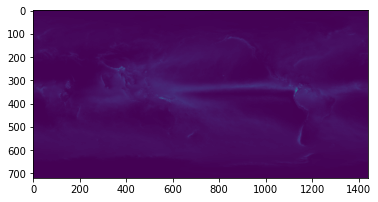

min: 3.814697177584314e-08 | max: 0.021926093846559525


In [3]:
tp_tm = torch.as_tensor(np.load(params.precip_time_means))

sc = tp_tm.max()
plt.imshow(tp_tm[0, 0], norm=Normalize(0., sc))
plt.show()

print(f'min: {tp_tm.min()} | max: {tp_tm.max()}')

tp_tms = [tp_tm.to(f'cuda:{i}') for i in range(4)]

2022-07-14 17:56:31,641 - root - INFO - Getting file stats from /pscratch/sd/s/shas1693/data/era5/test/2016.h5
2022-07-14 17:56:31,642 - root - INFO - Number of samples per year: 1460
2022-07-14 17:56:31,642 - root - INFO - Found data at path /pscratch/sd/s/shas1693/data/era5/test. Number of examples: 2920. Image Shape: 720 x 1440 x 20
2022-07-14 17:56:31,643 - root - INFO - Delta t: 6 hours
2022-07-14 17:56:31,643 - root - INFO - Including 0 hours of past history in training at a frequency of 6 hours


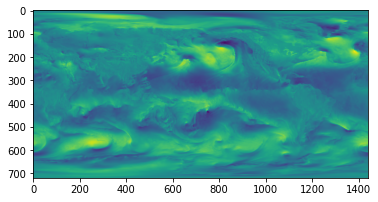

In [4]:
valid_data_loader, valid_dataset, valid_sampler = get_data_loader(params, distributed=False, train=False)

plt.imshow(valid_dataset[0][0][0])
plt.show()

In [5]:
pix2pix_models = []

for i in range(4):

    pix2pix_model = Pix2PixModel(params, False, 0, device=i)
    checkpoint = torch.load(ckpt_path, map_location=f'cuda:{i}')
    for key in checkpoint.keys():
        if 'model_state' in key and checkpoint[key] is not None:
            consume_prefix_in_state_dict_if_present(checkpoint[key], 'module.')
    pix2pix_model.load_state(checkpoint)
    pix2pix_model.set_eval()
    pix2pix_models.append(pix2pix_model)

Network [TSITGenerator] was created. Total number of parameters: 407.0 million. To see the architecture, do print(network).
Network [MultiscaleDiscriminator] was created. Total number of parameters: 11.1 million. To see the architecture, do print(network).
Network [TSITGenerator] was created. Total number of parameters: 407.0 million. To see the architecture, do print(network).
Network [MultiscaleDiscriminator] was created. Total number of parameters: 11.1 million. To see the architecture, do print(network).
Network [TSITGenerator] was created. Total number of parameters: 407.0 million. To see the architecture, do print(network).
Network [MultiscaleDiscriminator] was created. Total number of parameters: 11.1 million. To see the architecture, do print(network).
Network [TSITGenerator] was created. Total number of parameters: 407.0 million. To see the architecture, do print(network).
Network [MultiscaleDiscriminator] was created. Total number of parameters: 11.1 million. To see the archi

In [6]:
afno_winds = []
afno_precips = []

for i in range(4):
    
    params.N_in_channels = params.afno_wind_N_channels
    params.N_out_channels = params.afno_wind_N_channels

    afno_wind = AFNONet(params).to(f'cuda:{i}')
    afno_wind = load_afno(afno_wind,
                          params,
                          params.afno_model_wind_path,
                          map_location=torch.device(f'cuda:{i}'))
    afno_wind = afno_wind.to(f'cuda:{i}')
    afno_winds.append(afno_wind)

    # precip model
    params.N_out_channels = len(params.out_channels)
    afno_precip = AFNONet(params).to(f'cuda:{i}')
    afno_precip = PrecipNet(params, backbone=afno_precip).to(f'cuda:{i}')
    afno_precip = load_afno(afno_precip,
                            params,
                            params.afno_model_precip_path,
                            map_location=torch.device(f'cuda:{i}'))
    afno_precip = afno_precip.to(f'cuda:{i}')
    afno_precips.append(afno_precip)
    

In [7]:
acc = []
afno_acc = []
amps = {}
spectra_mean = {}
spectra_stderr = {}

In [8]:
data = [None] * 4

best_acc = 0.
worst_acc = 1.

best = { 'acc': 0. }
worst = { 'acc': 1. }
median = { 'acc': .5 }

with torch.inference_mode():

    for idx, (image, target) in enumerate(tqdm(valid_data_loader)):
        
        idx = 0
        
        data[idx % 4] = (image.to(f'cuda:{idx % 4}'), target.to(f'cuda:{idx % 4}'))
        amps.setdefault('era5', []).append(torch.fft.rfft(data[idx % 4][1], dim=-1, norm='ortho').abs().mean(dim=-2))
       
        # tsit
        gen, _ = pix2pix_models[idx % 4].generate_fake(data[idx % 4][0], data[idx % 4][1])
        gen_unlog = unlog_tp_torch(gen, params.precip_eps)
        tar_unlog = unlog_tp_torch(data[idx % 4][1], params.precip_eps)
        acc.append(weighted_acc_torch_channels(gen_unlog - tp_tms[idx % 4], tar_unlog - tp_tms[idx % 4]))
        amps.setdefault('tsit', []).append(torch.fft.rfft(gen, dim=-1, norm='ortho').abs().mean(dim=-2))

        # afno
        afno_pred = afno_precips[idx % 4](afno_winds[idx % 4](data[idx % 4][0]))
        afno_unlog = unlog_tp_torch(afno_pred, params.precip_eps)
        afno_acc.append(weighted_acc_torch_channels(afno_unlog - tp_tms[idx % 4], tar_unlog - tp_tms[idx % 4]))
        amps.setdefault('afno', []).append(torch.fft.rfft(afno_pred, dim=-1, norm='ortho').abs().mean(dim=-2))
        
        if acc[-1].max() > best['acc']:
            obs_idx = acc[-1].argmax()
            best['acc'] = acc[-1][obs_idx].item()
            best['afno_acc'] = afno_acc[-1][obs_idx].item()
            best['tsit'] = gen[obs_idx][0].detach().cpu().numpy()
            best['afno'] = afno_pred[obs_idx][0].detach().cpu().numpy()
            best['era5'] = data[idx % 4][1][obs_idx][0].detach().cpu().numpy()
            best['tsit_amp'] = amps['tsit'][-1][obs_idx][0].detach().cpu().numpy()
            best['afno_amp'] = amps['afno'][-1][obs_idx][0].detach().cpu().numpy()
            best['era5_amp'] = amps['era5'][-1][obs_idx][0].detach().cpu().numpy()
            
        if acc[-1].min() < worst['acc']:
            obs_idx = acc[-1].argmin()
            worst['acc'] = acc[-1][obs_idx].item()
            worst['afno_acc'] = afno_acc[-1][obs_idx].item()
            worst['tsit'] = gen[obs_idx][0].detach().cpu().numpy()
            worst['afno'] = afno_pred[obs_idx][0].detach().cpu().numpy()
            worst['era5'] = data[idx % 4][1][obs_idx][0].detach().cpu().numpy()
            worst['tsit_amp'] = amps['tsit'][-1][obs_idx][0].detach().cpu().numpy()
            worst['afno_amp'] = amps['afno'][-1][obs_idx][0].detach().cpu().numpy()
            worst['era5_amp'] = amps['era5'][-1][obs_idx][0].detach().cpu().numpy()
            
        med_idx = None
        if acc[-1][0].item() == torch.cat(acc).median().item():
            med_idx = 0
        if acc[-1][1].item() == torch.cat(acc).median().item():
            med_idx = 1
        if med_idx is not None:
            median['acc'] = acc[-1][med_idx].item()
            median['afno_acc'] = afno_acc[-1][med_idx].item()
            median['tsit'] = gen[med_idx][0].detach().cpu().numpy()
            median['afno'] = afno_pred[med_idx][0].detach().cpu().numpy()
            median['era5'] = data[idx % 4][1][med_idx][0].detach().cpu().numpy()
            median['tsit_amp'] = amps['tsit'][-1][med_idx][0].detach().cpu().numpy()
            median['afno_amp'] = amps['afno'][-1][med_idx][0].detach().cpu().numpy()
            median['era5_amp'] = amps['era5'][-1][med_idx][0].detach().cpu().numpy()

        # if len(acc) >= len(valid_data_loader) // 32:
        #    break

        # print(f'tsit acc: {acc[-1].mean().item()}')
        # print(f'afno acc: {afno_acc[-1].mean().item()}')

for i, _ in enumerate(acc):
    acc[i] = acc[i].detach().cpu()
    afno_acc[i] = afno_acc[i].detach().cpu()
    
acc = torch.cat(acc)
afno_acc = torch.cat(afno_acc)

  0%|          | 0/1460 [00:00<?, ?it/s]/opt/conda/lib/python3.8/site-packages/torch/nn/functional.py:3839: UserWarning: The default behavior for interpolate/upsample with float scale_factor changed in 1.6.0 to align with other frameworks/libraries, and now uses scale_factor directly, instead of relying on the computed output size. If you wish to restore the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn(
100%|██████████| 1460/1460 [11:45<00:00,  2.07it/s]


tsit acc -- mean: 0.311 | median: 0.241 | min: 0.001 | max: 0.784
afno acc -- mean: 0.534 | median: 0.450 | min: 0.134 | max: 0.868
corr(tsit acc, afno acc): 0.795


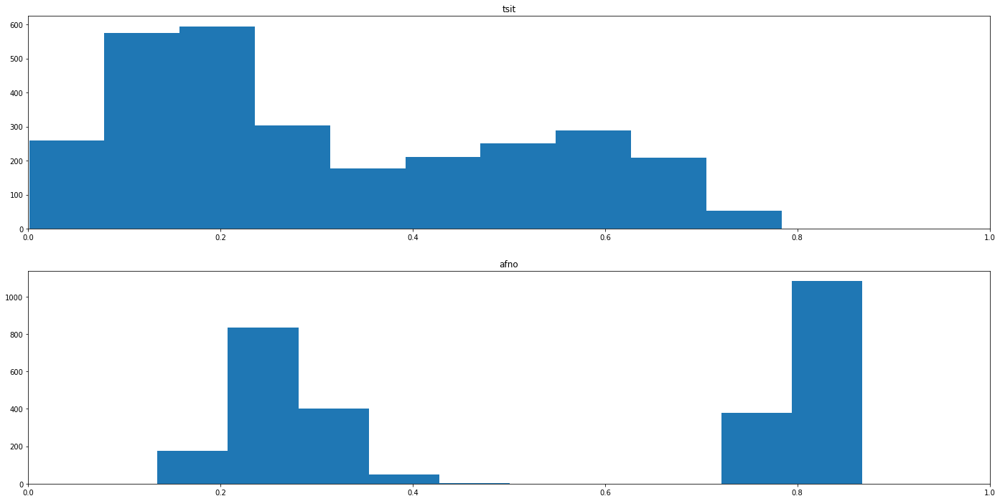

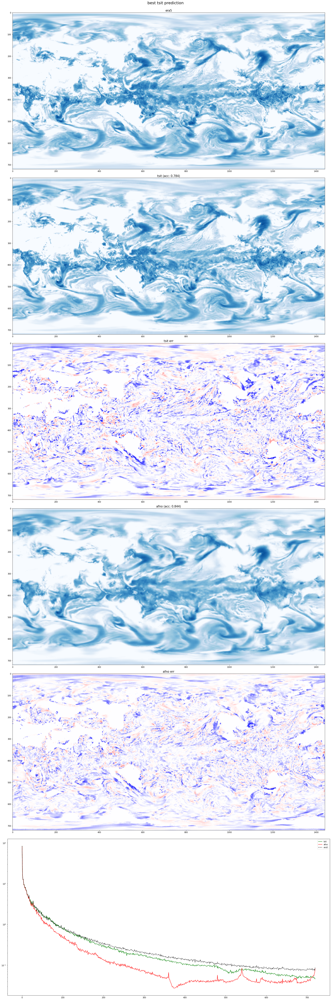

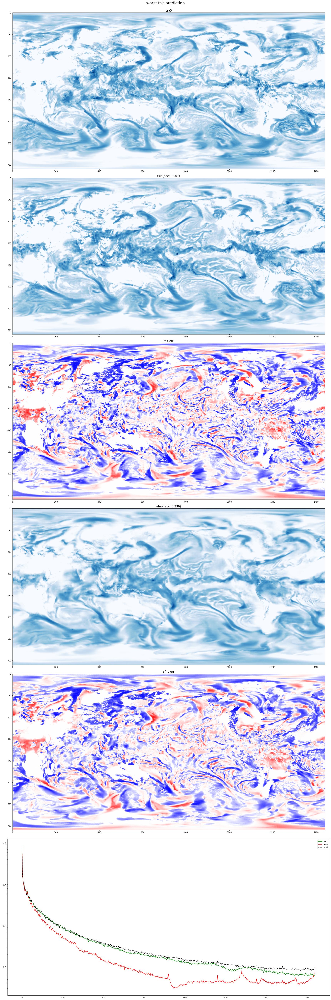

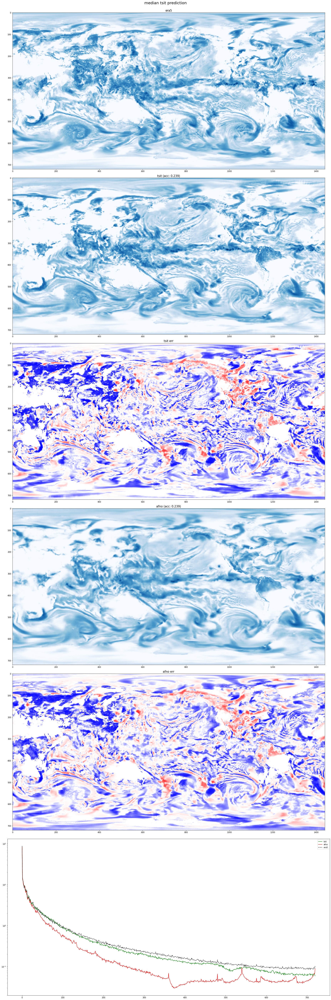

In [28]:
print(f'tsit acc -- mean: {acc.mean().item():.3f} | median: {acc.median().item():.3f} | min: {acc.min().item():.3f} | max: {acc.max().item():.3f}')
print(f'afno acc -- mean: {afno_acc.mean().item():.3f} | median: {afno_acc.median().item():.3f} | min: {afno_acc.min().item():.3f} | max: {afno_acc.max().item():.3f}')
print(f'corr(tsit acc, afno acc): {np.corrcoef(acc.cpu().numpy().flatten(), afno_acc.cpu().numpy().flatten())[0, 1]:.3f}')

plt.figure(figsize=(24, 12))

plt.subplot(2,1,1)
plt.hist(acc.cpu().numpy().flatten())
plt.xlim([0., 1.])
plt.title('tsit')

plt.subplot(2,1,2)
plt.hist(afno_acc.cpu().numpy().flatten())
plt.xlim([0., 1.])
plt.title('afno')
plt.show()

plt_fmt = {
    'tsit': 'g-',
    'era5': 'k--',
    'afno': 'r-',
}

for suptitle, fields in [('best', best), ('worst', worst), ('median', median)]:
    plt.figure(figsize=(24, 72))
    
    sc = fields['era5'].max()
    
    plt.subplot(6,1,1)
    plt.imshow(fields['era5'], norm=Normalize(0., sc), cmap='Blues')
    plt.title('era5', fontsize=15)
    
    plt.subplot(6,1,2)
    plt.imshow(fields['tsit'], norm=Normalize(0., sc), cmap='Blues')
    plt.title(f'tsit (acc: {fields["acc"]:.3f})', fontsize=15)
    
    plt.subplot(6,1,3)
    tsit_err = (fields['tsit'] - fields['era5']) / (fields['era5'] + 1.)
    plt.imshow(tsit_err, norm=TwoSlopeNorm(0., tsit_err.min(), tsit_err.max()), cmap='bwr')
    plt.title(f'tsit err', fontsize=15)

    plt.subplot(6,1,4)
    plt.imshow(fields['afno'], norm=Normalize(0., sc), cmap='Blues')
    plt.title(f'afno (acc: {fields["afno_acc"]:.3f})', fontsize=15)
    
    plt.subplot(6,1,5)
    plt.imshow((fields['afno'] - fields['era5']) / (fields['era5'] + 1.), 
               norm=TwoSlopeNorm(0., tsit_err.min(), tsit_err.max()), cmap='bwr')
    plt.title(f'afno err', fontsize=15)
    
    plt.subplot(6,1,6)    
    for key in ['tsit', 'afno', 'era5']:
        wavenum = np.arange(start=0, stop=len(fields[f'{key}_amp']))
        plt.semilogy(wavenum, fields[f'{key}_amp'], plt_fmt[key], label=key) 
    plt.legend()

    plt.suptitle(f'{suptitle} tsit prediction', fontsize=20, x=0.5, y=1)

    plt.tight_layout()
    plt.show()

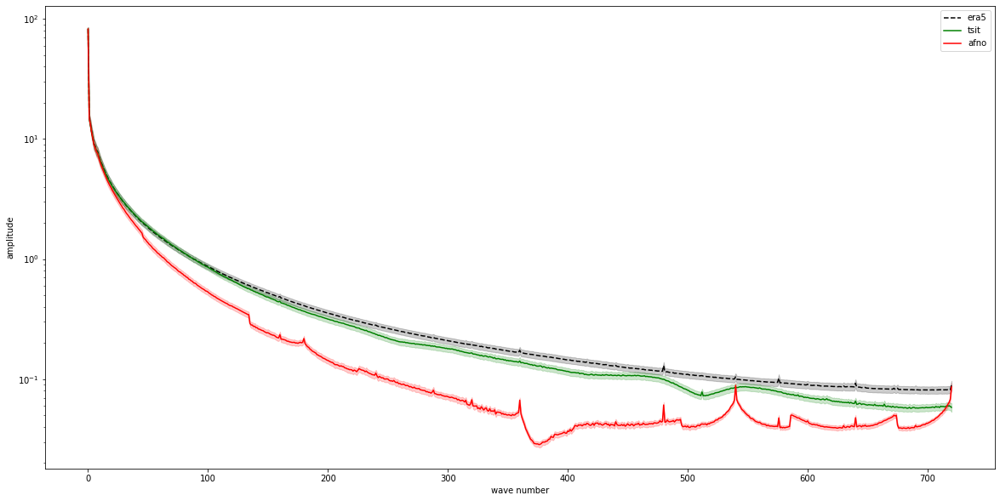

In [18]:
for key, amp in amps.items():
    # take mean across latitudes
    # amps = torch.cat(fft)[:, 0].abs().mean(dim=-2)
    # calc mean and standard error across validation obs
    for i, _ in enumerate(amp):
        amp[i] = amp[i].detach().cpu()
    amp = torch.cat(amp)[:, 0]
    # if len(amp.shape) == 3:
    #     amp = amp[:, 0]
    std_mean = torch.std_mean(amp, dim=0)
    spectra_mean[key] = std_mean[1].detach().cpu().numpy()
    spectra_stderr[key] = std_mean[0].detach().cpu().numpy() #/ np.sqrt(amp.shape[0])

f = plt.figure(figsize=(20, 10))

for key in spectra_mean.keys():
    mean = spectra_mean[key]
    stderr = spectra_stderr[key]
    wavenum = np.arange(start=0, stop=len(mean))
    plt.semilogy(wavenum, mean, plt_fmt[key], label=key)
    plt.fill_between(wavenum, mean - stderr, mean + stderr,
                     color=plt_fmt[key][0], alpha=0.2)
    #plt.yscale('log')
    #plt.errorbar(wavenum, mean, stderr, fmt=plt_fmt[key], label=key)

plt.xlabel('wave number')
plt.ylabel('amplitude')
plt.legend()
plt.show()

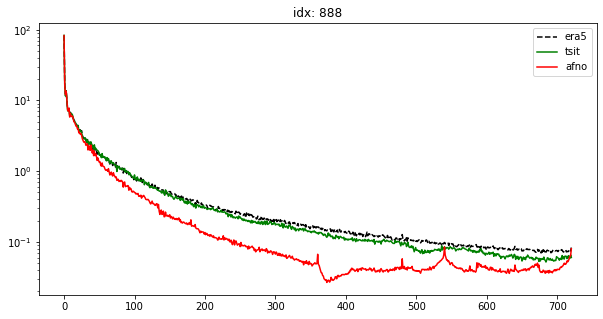

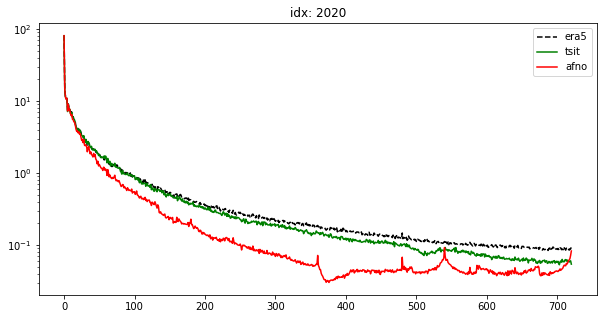

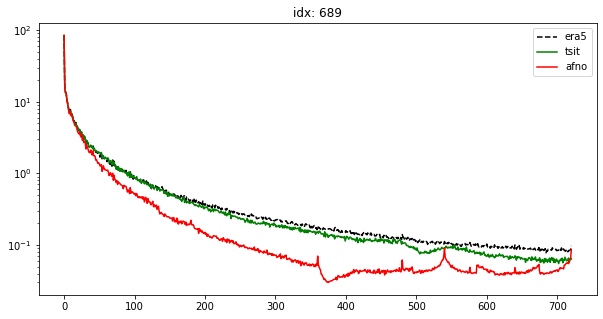

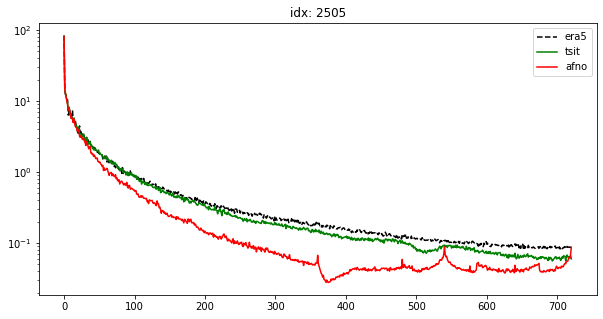

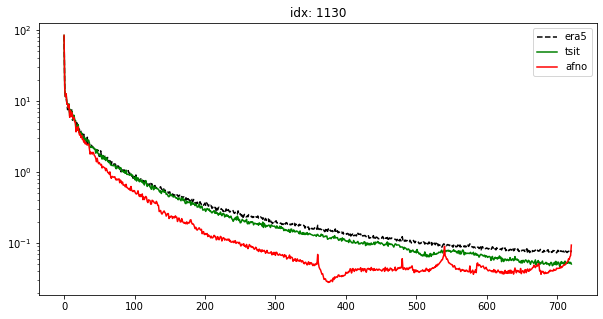

In [19]:
samp_idxs = np.random.randint(len(amps['era5']) * amps['era5'][0].shape[0], size=5)

for idx in samp_idxs: 
    
    f = plt.figure(figsize=(10, 5))
    
    for key, amp in amps.items():
        amp = torch.cat(amp)[:, 0]
        plt.semilogy(wavenum, amp[idx], plt_fmt[key], label=key)
        
    plt.legend()
    plt.title(f'idx: {idx}')